In [5]:
import geopandas as gpd
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import numpy as np
import analysis_plotting as vis
import importlib

# After editing the module, reload it
importlib.reload(vis)
import os


# Increase the maximum number of columns displayed
pd.set_option('display.max_columns', None)

# If you want to display more rows as well, you can increase the row limit
pd.set_option('display.max_rows', None)


Load data

In [3]:
### Load boston
file_path_boston = '../results/output/2315704/2315704_verhardingen_with_stats_multiple_dates.gpkg'
dates_to_reverse = ['20240620', '20240715']
clean_boston, melt_boston = vis.process_and_reverse_columns(file_path_boston, dates_to_reverse)

### Load Amsterdam
file_path_amsterdam = '../results/output/271110/271110_verhardingen_with_stats_multiple_dates.gpkg'
dates_to_reverse = ['20240515', '20240620', '20240715', '20240815', '20240922']
clean_amsterdam, melt_amsterdam = vis.process_and_reverse_columns(file_path_amsterdam, dates_to_reverse)

#### Further processing for AMSTERDAM:
buurten_path = '../data/raw_data/ams/geojson_lnglat.json'
clean_amsterdam = vis.preprocess_amsterdam_data(clean_amsterdam, buurten_path)

### Load Cambridge
file_path_cambridge = '../results/output/1933745/1933745_verhardingen_with_stats_multiple_dates.gpkg'
dates_to_reverse = ['20240620', '20240715']
clean_cambridge, melt_cambridge = vis.process_and_reverse_columns(file_path_cambridge, dates_to_reverse)

file_path_singapore = '../results/output/536780/536780_verhardingen_with_stats_multiple_dates.gpkg'
dates_to_reverse = ['20240215','20240320', '20240415', '20240515']
clean_singapore, melt_singapore = vis.process_and_reverse_columns(file_path_singapore, dates_to_reverse)

/opt/anaconda3/envs/throwing_shade/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/anaconda3/envs/throwing_shade/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/anaconda3/envs/throwing_shade/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

In [3]:
file_path_singapore = '../results/output/536780/536780_verhardingen_with_stats_multiple_dates.gpkg'
dates_to_reverse = ['20240215','20240320', '20240415', '20240515']
clean_singapore, melt_singapore = vis.process_and_reverse_columns(file_path_singapore, dates_to_reverse)

/opt/anaconda3/envs/throwing_shade/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [ ]:
clean_singapore.explore()

In [4]:
time_increments = ['1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700']
date = '20240620'
avg_column_name = f'{date}_tree_shade_percent_day_average'

# Call the function
clean_boston = vis.calculate_daily_average_shade(clean_boston, time_increments, date, avg_column_name)
clean_amsterdam = vis.calculate_daily_average_shade(clean_amsterdam, time_increments, date, avg_column_name)
clean_cambridge = vis.calculate_daily_average_shade(clean_cambridge, time_increments, date, avg_column_name)

array([[<Axes: title={'center': '20240320_shade_index'}>]], dtype=object)

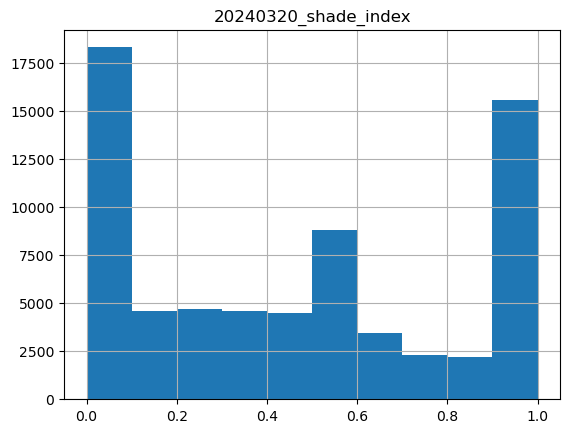

In [6]:
time_increments = ['1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700']
date = '20240320'
score_column_name = f'{date}_shade_index'
threshold = 30

clean_singapore = vis.calculate_shade_score(clean_singapore, time_increments, date, score_column_name, threshold)

clean_singapore.hist(column=f'{date}_shade_index')

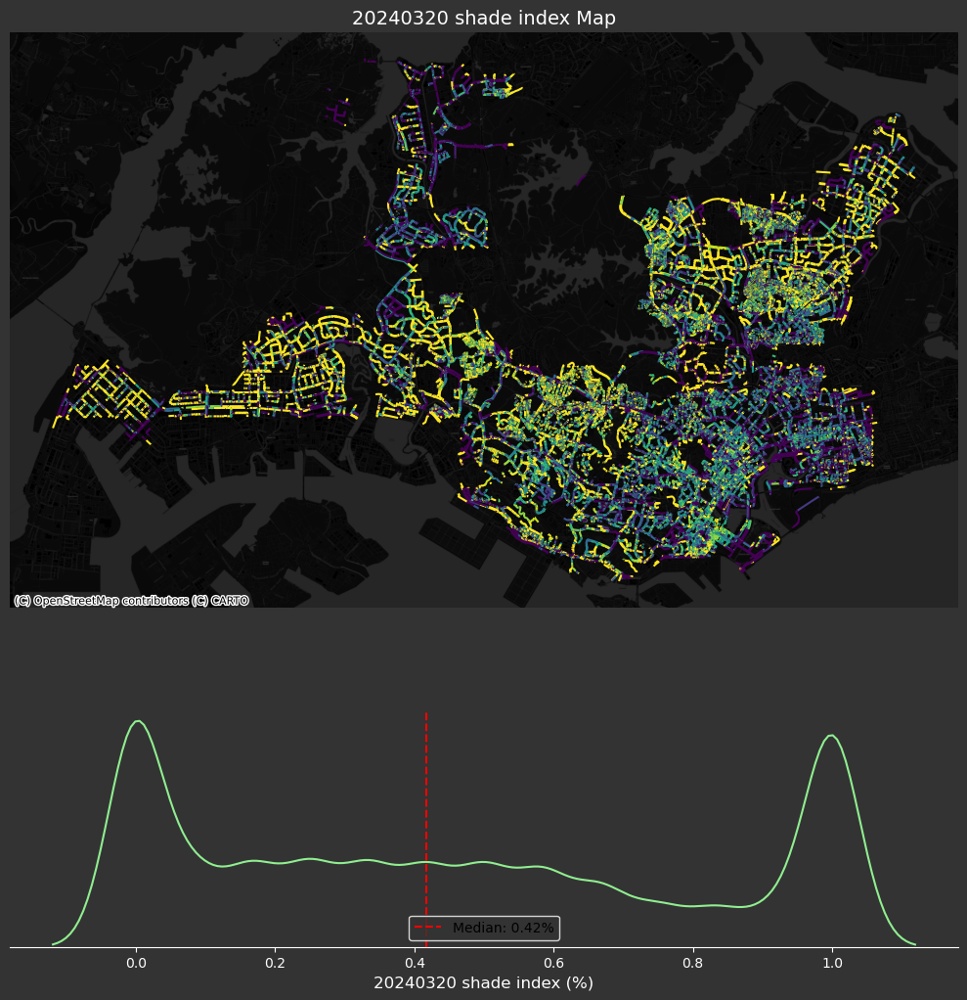

In [9]:
#Usage example:
plot_shade_distribution(clean_singapore, '20240320_shade_index')

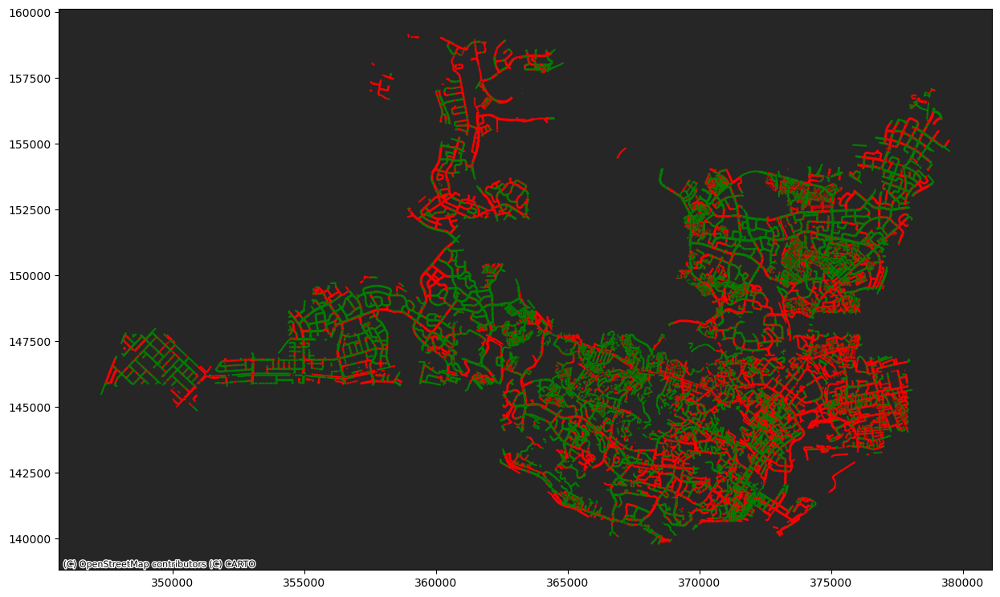

In [30]:
import contextily as ctx

fig, ax = plt.subplots(figsize=(15, 15))

# Filter the GeoDataFrame and plot
clean_singapore[clean_singapore["20240320_shade_index"] <= 0.5].plot(
    ax=ax, legend=True, color='red'
)

# Filter the GeoDataFrame and plot
clean_singapore[clean_singapore["20240320_shade_index"] > 0.5].plot(
    ax=ax, legend=True, color='green'
)
basemap=ctx.providers.CartoDB.DarkMatter
# Add a dark basemap (from contextily)
ctx.add_basemap(
    ax, 
    source=basemap, 
    )

plt.show()

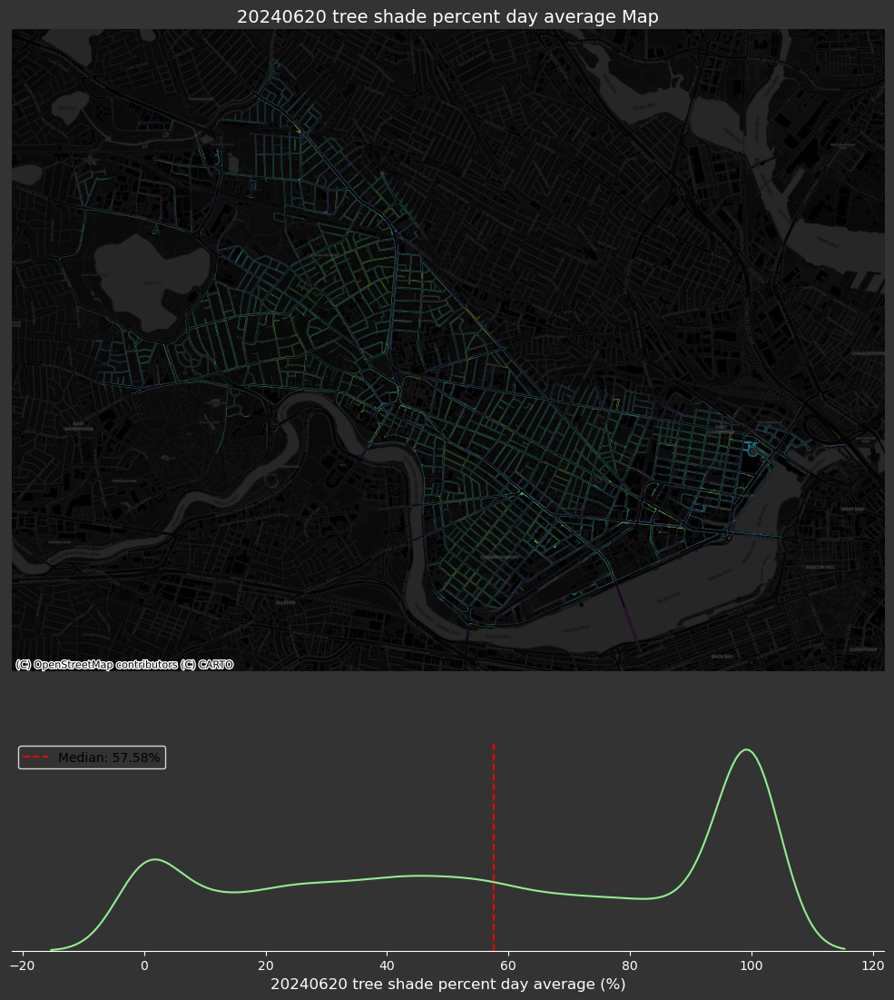

In [9]:
plot_shade_distribution(sidewalks_cam, '20240620_tree_shade_percent_day_average')

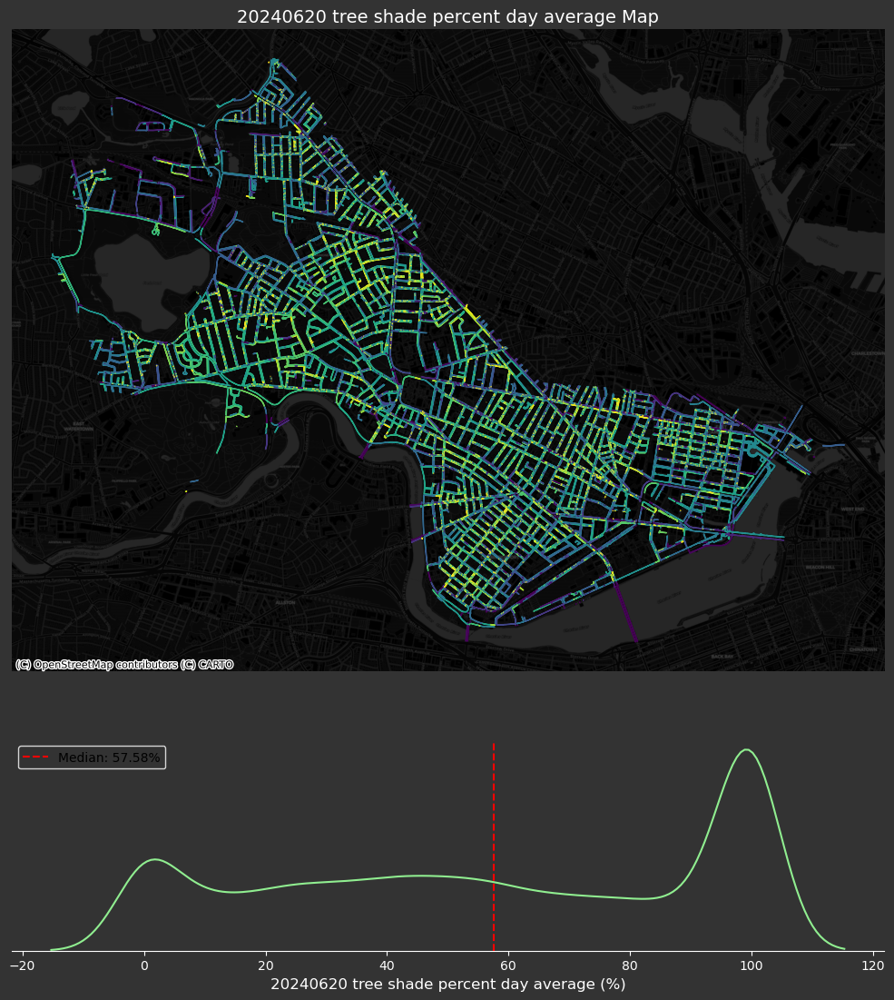

In [21]:
vis.plot_shade_distribution(sidewalks_cam, '20240620_tree_shade_percent_day_average', theme='dark', save_path='../results/figures/shade_plot_cambridge_all_dark.png')

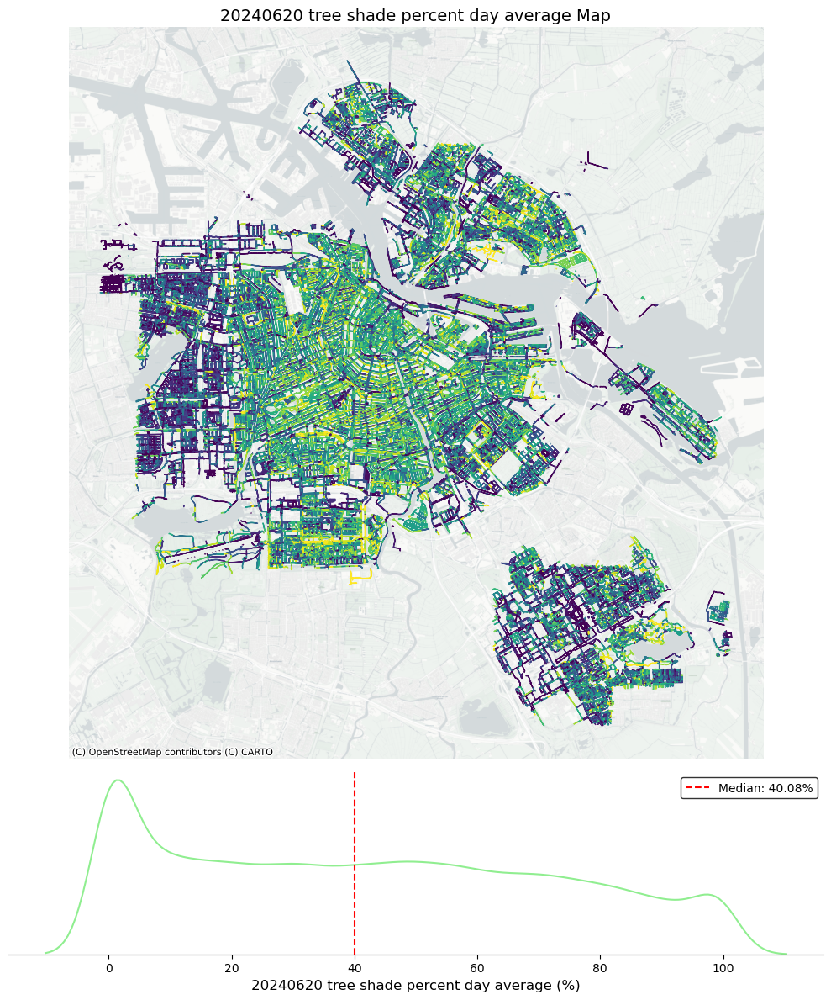

In [23]:
vis.plot_shade_distribution(sidewalks_ams, '20240620_tree_shade_percent_day_average', theme='light', save_path='../results/figures/shade_plot_amsterdam_all_light.png')

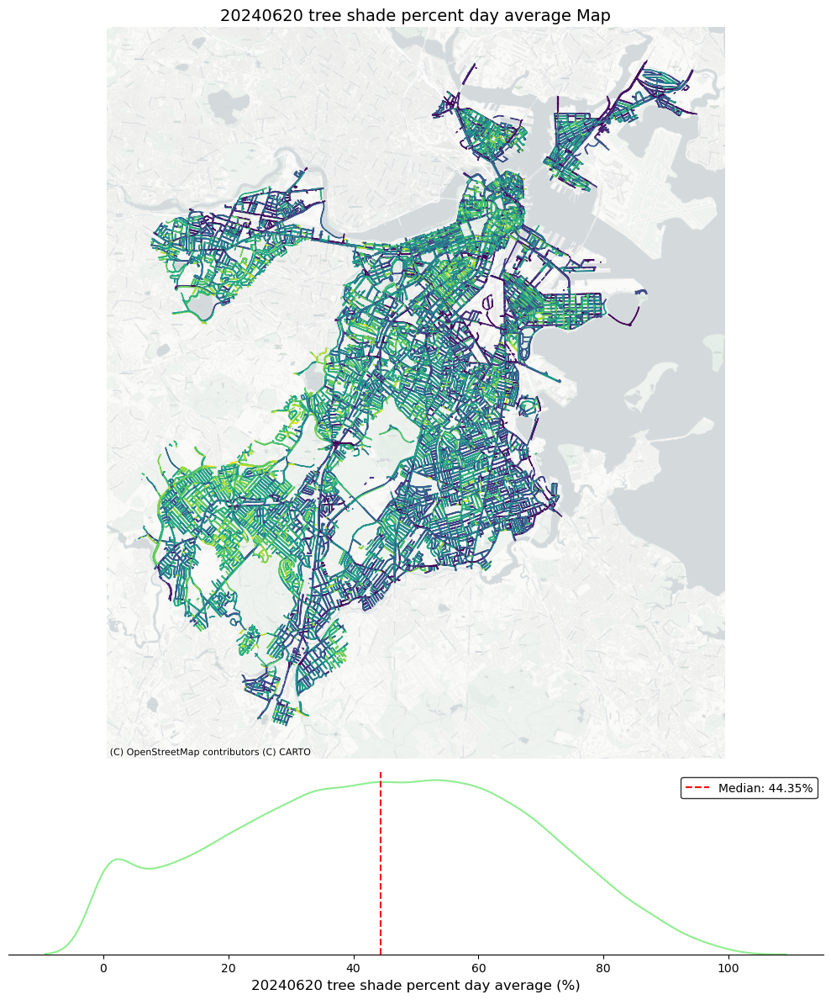

In [25]:
vis.plot_shade_distribution(clean_boston, '20240620_tree_shade_percent_day_average', theme='light', save_path='../results/figures/shade_plot_boston_all_light.png')

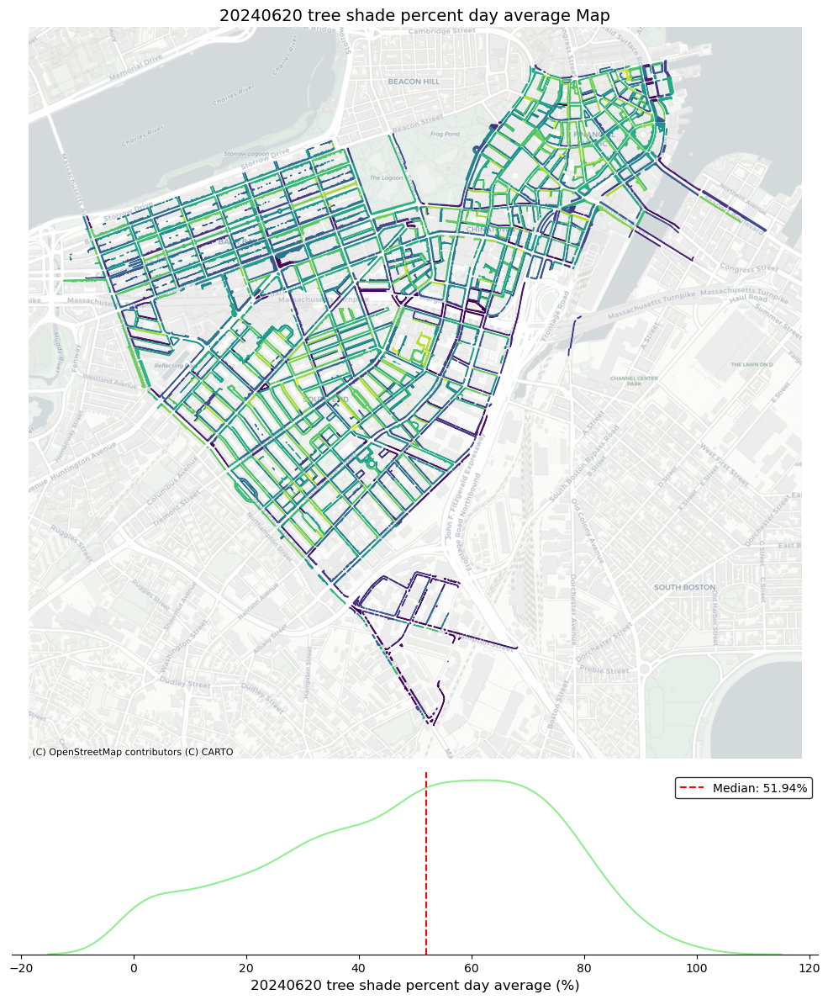

In [27]:
vis.plot_shade_distribution(downtown, '20240620_tree_shade_percent_day_average', theme='light', save_path='../results/figures/shade_plot_boston_downtown_all_light.png')

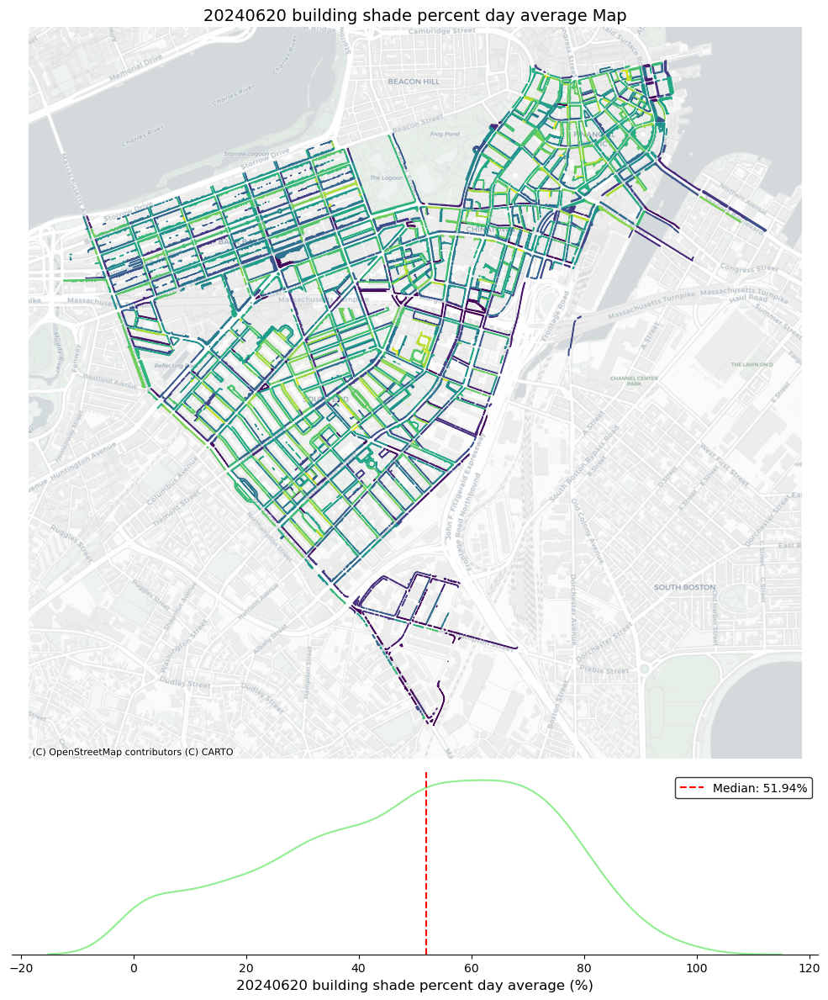

In [32]:
vis.plot_shade_distribution(downtown, '20240620_building_shade_percent_day_average', theme='light', save_path='../results/figures/shade_plot_boston_downtown_all_buildings_light.png')

In [9]:
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import contextily as ctx

def plot_hexmap_shade_distribution(gdf, column_name, cmap='viridis', 
                                   theme='dark', zoom=15, save_path=None):
    """
    Visualizes a hexmap of a GeoDataFrame's polygon data on a map with a dark or light background and 
    displays the distribution of the values in a column with the median highlighted.
    
    Parameters:
    - gdf: GeoDataFrame containing polygon data
    - column_name: The name of the column to visualize (must contain numeric data)
    - cmap: Colormap for the hexmap visualization (default 'viridis')
    - theme: 'dark' for dark background (CartoDB DarkMatter) or 'light' for light background (CartoDB Positron)
    - zoom: Zoom level for the basemap (default 15)
    - save_path: If provided, the plot will be saved to the specified file path
    """
    # Choose basemap and styling based on theme
    if theme == 'dark':
        basemap = ctx.providers.CartoDB.DarkMatter
        bg_color = '#333333'
        text_color = 'white'
        spine_color = 'white'
    else:
        basemap = ctx.providers.CartoDB.Positron
        bg_color = 'white'
        text_color = 'black'
        spine_color = 'black'

    # Reproject to Web Mercator (EPSG:3857) for basemap alignment
    gdf = gdf.to_crs(epsg=3857)

    # Calculate centroids of each polygon for hexbin plotting
    gdf['centroid'] = gdf.centroid

    # Extract x and y coordinates of the centroids
    x = gdf['centroid'].x
    y = gdf['centroid'].y
    values = gdf[column_name]

    # Plotting
    fig, ax = plt.subplots(2, 1, figsize=(10, 12), gridspec_kw={'height_ratios': [4, 1]})

    # 1. Hexmap Visualization with Chosen Background
    hb = ax[0].hexbin(x, y, C=values, gridsize=50, cmap=cmap, reduce_C_function=np.mean)

    # Add basemap (from contextily)
    ctx.add_basemap(
        ax[0], 
        source=basemap, 
        zoom=zoom
    )

    # Remove axis for the map
    ax[0].axis('off')
    ax[0].set_title(f'{column_name.replace("_", " ").capitalize()} Hexmap', fontsize=14, color=text_color)

    # Add color bar to show scale of values
    cb = plt.colorbar(hb, ax=ax[0])
    cb.set_label(f'{column_name.replace("_", " ").capitalize()} (%)')

    # 2. Distribution Graph with Highlighted Median
    sns.kdeplot(
        gdf[column_name], 
        color='lightgreen', 
        ax=ax[1]
    )  # Show a smooth line for the distribution

    # Highlight median
    median_val = gdf[column_name].median()
    ax[1].axvline(median_val, color='red', linestyle='--', label=f'Median: {median_val:.2f}%')

    # Formatting the distribution plot
    ax[1].set_xlabel(f'{column_name.replace("_", " ").capitalize()} (%)', fontsize=12, color=text_color)
    ax[1].set_ylabel('')
    ax[1].set_yticks([])  # Remove y-axis labels
    ax[1].legend()

    # Set background and text color for the distribution plot
    ax[1].set_facecolor(bg_color)
    fig.patch.set_facecolor(bg_color)
    ax[1].spines['left'].set_color(bg_color)
    ax[1].spines['right'].set_color(bg_color)
    ax[1].spines['top'].set_color(bg_color)
    ax[1].spines['bottom'].set_color(spine_color)

    # Update tick and label colors for readability
    ax[1].tick_params(colors=text_color)
    ax[1].xaxis.label.set_color(text_color)
    ax[1].legend(facecolor=bg_color, edgecolor=spine_color)

    # Adjust layout
    plt.tight_layout()

    # Save the plot if save_path is provided
    if save_path:
        plt.savefig(save_path, dpi=300, facecolor=fig.get_facecolor(), edgecolor='none')

    # Display the plot
    plt.show()

# Usage example:
# plot_hexmap_shade_distribution(gdf, 'tree_shade_percent_day_average', theme='light', save_path='hexmap_shade_plot.png')

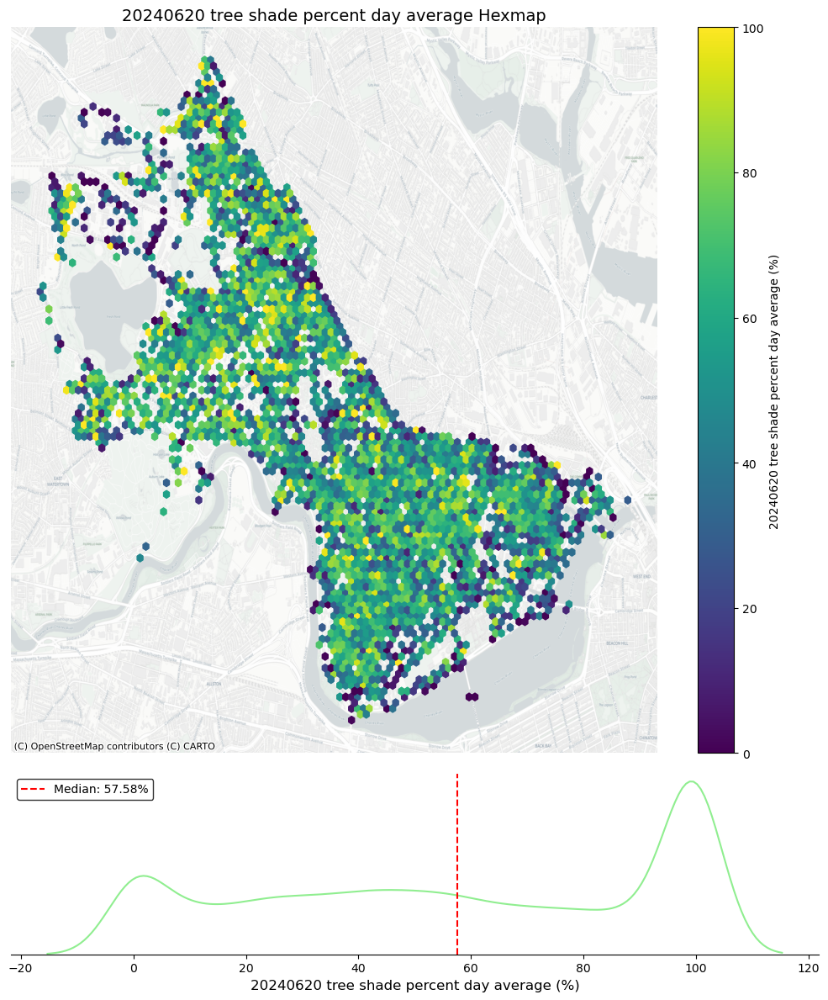

In [43]:
plot_hexmap_shade_distribution(sidewalks_cam, '20240620_tree_shade_percent_day_average', theme='light', save_path='../results/figures/hexmap_cambridge_light.png')

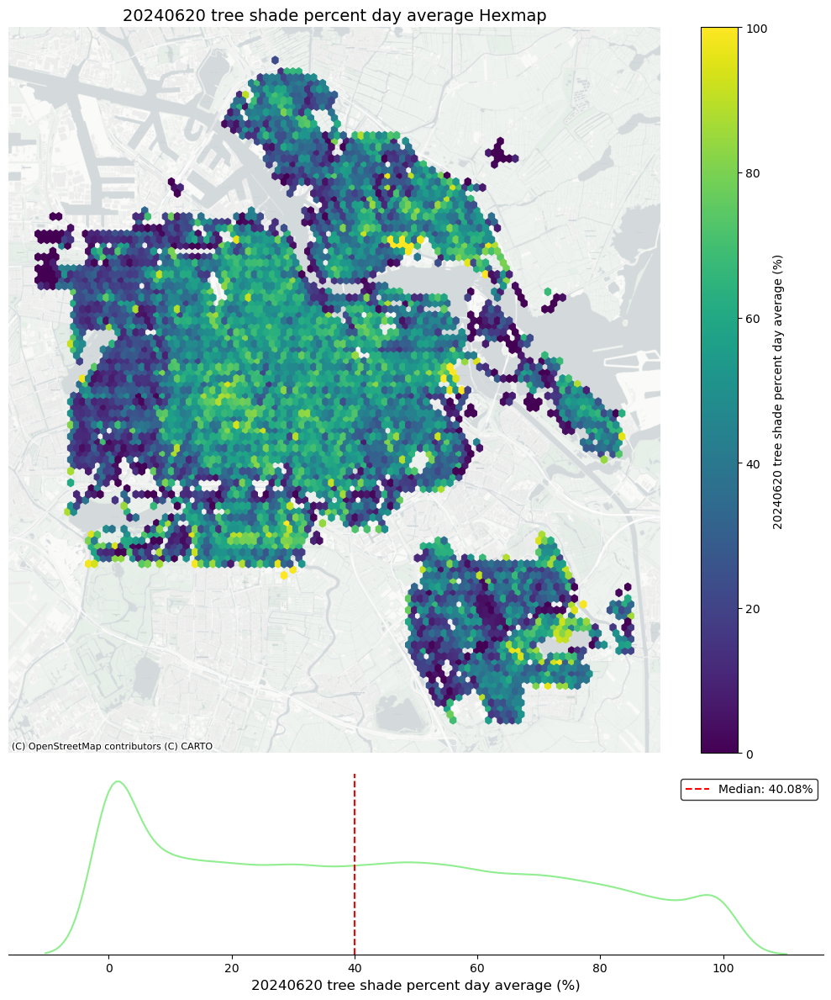

In [44]:
plot_hexmap_shade_distribution(sidewalks_ams, '20240620_tree_shade_percent_day_average', theme='light', save_path='../results/figures/hexmap_amsterdam_light.png')

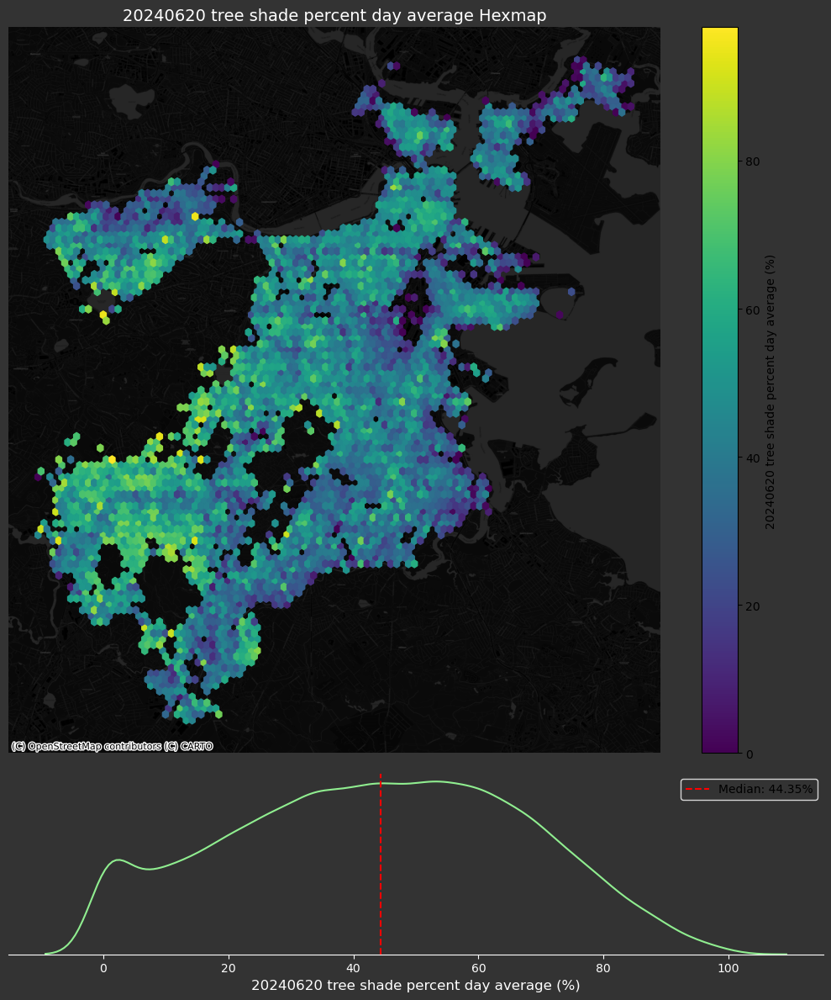

In [46]:
plot_hexmap_shade_distribution(clean_boston, '20240620_tree_shade_percent_day_average', theme='dark', save_path='../results/figures/hexmap_boston_dark.png')

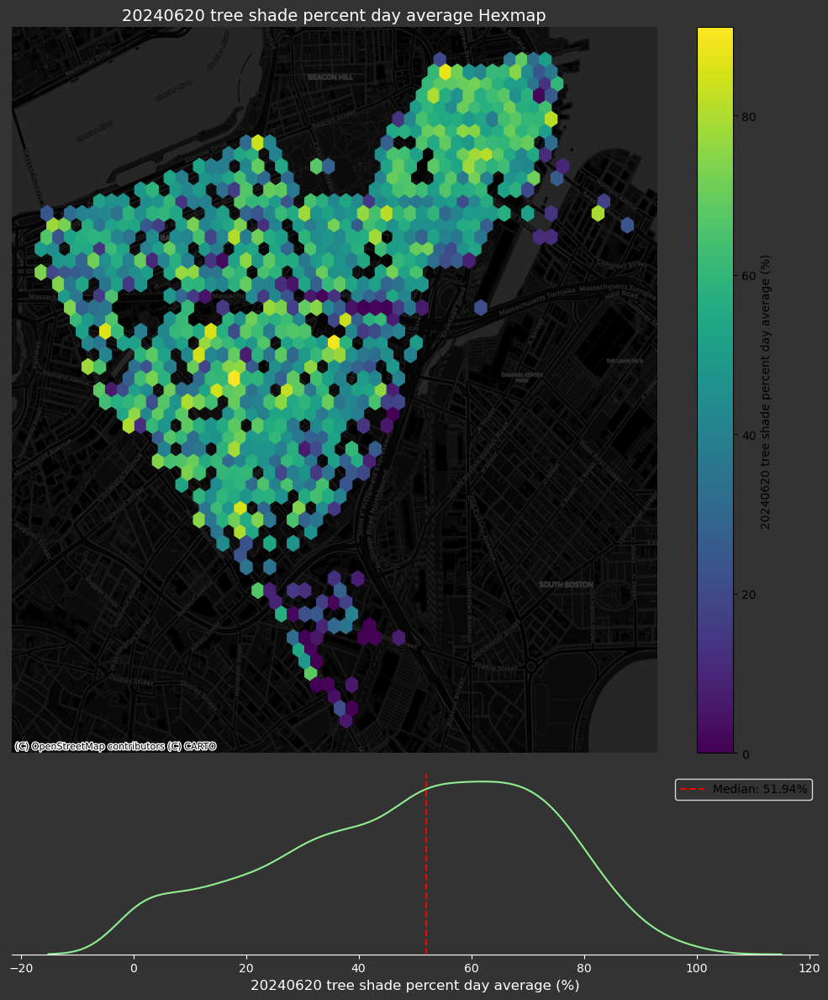

In [10]:
plot_hexmap_shade_distribution(downtown, '20240620_tree_shade_percent_day_average', theme='dark', save_path='../results/figures/hexmap_boston_downtown_dark.png')

Plot saved at ../results/figures/240930_2315704_daily_multiple_days_light.png


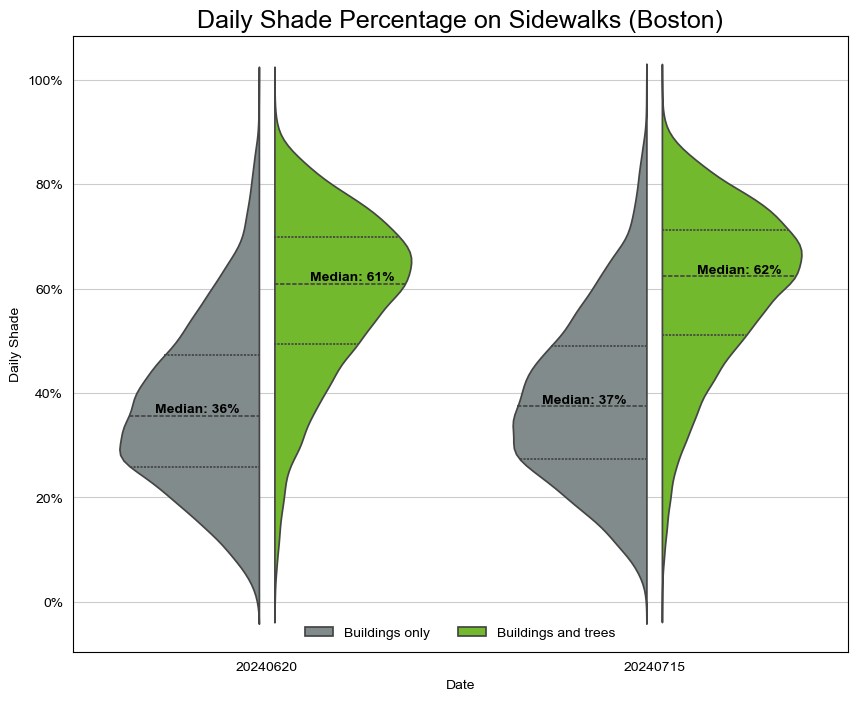

In [26]:
osmid = 2315704
# Example usage:
vis.plot_shade_metrics(melt_boston, background='light', title='Daily Shade Percentage on Sidewalks (Boston)', save_path='../results/figures/', file_name=f'240930_{osmid}_daily_multiple_days_light')

Plot saved at ../results/figures/240930_271110_daily_multiple_days_light.png


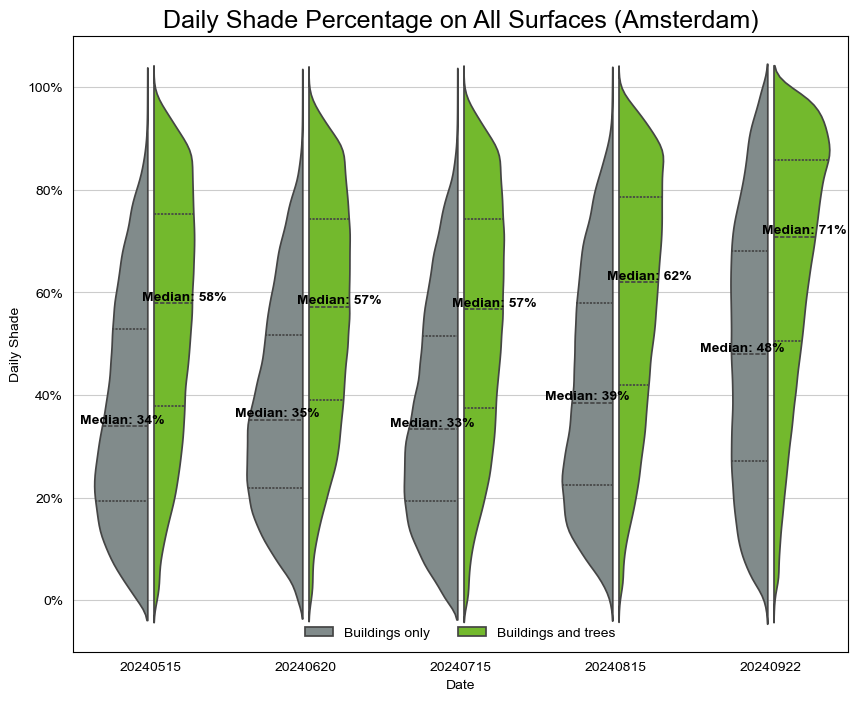

In [25]:
osmid = 271110
vis.plot_shade_metrics(melt_amsterdam, background='light', title='Daily Shade Percentage on All Surfaces (Amsterdam)', save_path='../results/figures/', file_name=f'240930_{osmid}_daily_multiple_days_light')

In [25]:
clean_cambridge.head()

,index,TYPE,surface_type,20240620_building_mean,20240620_building_std,20240620_building_min,20240620_building_max,20240620_building_shade_percent_at_0530,20240620_building_shade_percent_at_0600,20240620_building_shade_percent_at_0630,20240620_building_shade_percent_at_0700,20240620_building_shade_percent_at_0730,20240620_building_shade_percent_at_0800,20240620_building_shade_percent_at_0830,20240620_building_shade_percent_at_0900,20240620_building_shade_percent_at_0930,20240620_building_shade_percent_at_1000,20240620_building_shade_percent_at_1030,20240620_building_shade_percent_at_1100,20240620_building_shade_percent_at_1130,20240620_building_shade_percent_at_1200,20240620_building_shade_percent_at_1230,20240620_building_shade_percent_at_1300,20240620_building_shade_percent_at_1330,20240620_building_shade_percent_at_1400,20240620_building_shade_percent_at_1430,20240620_building_shade_percent_at_1500,20240620_building_shade_percent_at_1530,20240620_building_shade_percent_at_1600,20240620_building_shade_percent_at_1630,20240620_building_shade_percent_at_1700,20240620_building_shade_percent_at_1730,20240620_building_shade_percent_at_1800,20240620_building_shade_percent_at_1830,20240620_building_shade_percent_at_1900,20240620_building_shade_percent_at_1930,20240620_building_shade_percent_at_2000,20240620_tree_mean,20240620_tree_std,20240620_tree_min,20240620_tree_max,20240620_tree_shade_percent_at_0530,20240620_tree_shade_percent_at_0600,20240620_tree_shade_percent_at_0630,20240620_tree_shade_percent_at_0700,20240620_tree_shade_percent_at_0730,20240620_tree_shade_percent_at_0800,20240620_tree_shade_percent_at_0830,20240620_tree_shade_percent_at_0900,20240620_tree_shade_percent_at_0930,20240620_tree_shade_percent_at_1000,20240620_tree_shade_percent_at_1030,20240620_tree_shade_percent_at_1100,20240620_tree_shade_percent_at_1130,20240620_tree_shade_percent_at_1200,20240620_tree_shade_percent_at_1230,20240620_tree_shade_percent_at_1300,20240620_tree_shade_percent_at_1330,20240620_tree_shade_percent_at_1400,20240620_tree_shade_percent_at_1430,20240620_tree_shade_percent_at_1500,20240620_tree_shade_percent_at_1530,20240620_tree_shade_percent_at_1600,20240620_tree_shade_percent_at_1630,20240620_tree_shade_percent_at_1700,20240620_tree_shade_percent_at_1730,20240620_tree_shade_percent_at_1800,20240620_tree_shade_percent_at_1830,20240620_tree_shade_percent_at_1900,20240620_tree_shade_percent_at_1930,20240620_tree_shade_percent_at_2000,20240715_building_mean,20240715_building_std,20240715_building_min,20240715_building_max,20240715_building_shade_percent_at_0530,20240715_building_shade_percent_at_0600,20240715_building_shade_percent_at_0630,20240715_building_shade_percent_at_0700,20240715_building_shade_percent_at_0730,20240715_building_shade_percent_at_0800,20240715_building_shade_percent_at_0830,20240715_building_shade_percent_at_0900,20240715_building_shade_percent_at_0930,20240715_building_shade_percent_at_1000,20240715_building_shade_percent_at_1030,20240715_building_shade_percent_at_1100,20240715_building_shade_percent_at_1130,20240715_building_shade_percent_at_1200,20240715_building_shade_percent_at_1230,20240715_building_shade_percent_at_1300,20240715_building_shade_percent_at_1330,20240715_building_shade_percent_at_1400,20240715_building_shade_percent_at_1430,20240715_building_shade_percent_at_1500,20240715_building_shade_percent_at_1530,20240715_building_shade_percent_at_1600,20240715_building_shade_percent_at_1630,20240715_building_shade_percent_at_1700,20240715_building_shade_percent_at_1730,20240715_building_shade_percent_at_1800,20240715_building_shade_percent_at_1830,20240715_building_shade_percent_at_1900,20240715_building_shade_percent_at_1930,20240715_building_shade_percent_at_2000,20240715_tree_mean,20240715_tree_std,20240715_tree_min,20240715_tree_max,20240715_tree_shade_percent_at_0530,20240715_tree_shade_percent_at_0600,20240715_tree_shade_percent_at_0630,20240715_tree_shade_percent_at_0700,20240715_tree_shade_percent

Plot saved at ../results/figures/240930_1933745_daily_multiple_days_light.png


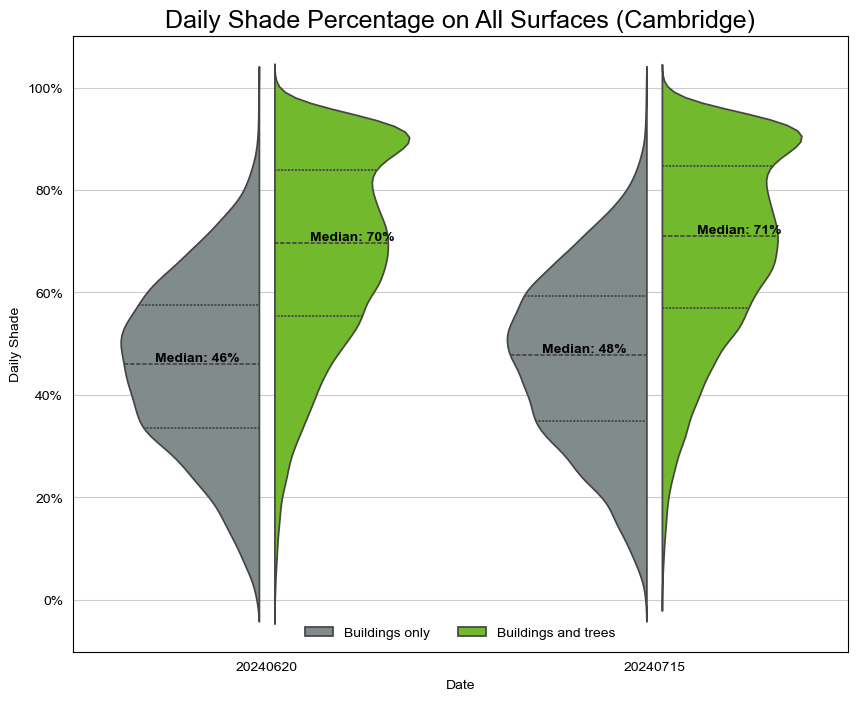

In [27]:
osmid = 1933745
vis.plot_shade_metrics(melt_cambridge, background='light', title='Daily Shade Percentage on All Surfaces (Cambridge)', save_path='../results/figures/', file_name=f'240930_{osmid}_daily_multiple_days_light')

In [5]:
cycling_ams = clean_amsterdam.loc[clean_amsterdam['Gebruiksfunctie']=='Cycle lane']
sidewalks_ams = clean_amsterdam.loc[clean_amsterdam['Gebruiksfunctie']=='Sidewalk']
driving_ams = clean_amsterdam.loc[clean_amsterdam['Gebruiksfunctie']=='Road']

sidewalks_cam = clean_cambridge.loc[clean_cambridge['surface_type']=='Sidewalks']

dates = ['20240620', '20240715']
melt_sidewalks_ams = vis.melt_gdf_for_plotting(sidewalks_ams, dates)
melt_sidewalks_cam = vis.melt_gdf_for_plotting(sidewalks_cam, dates)

Plot saved at ../results/figures/241001_daily_multiple_cities_light.png


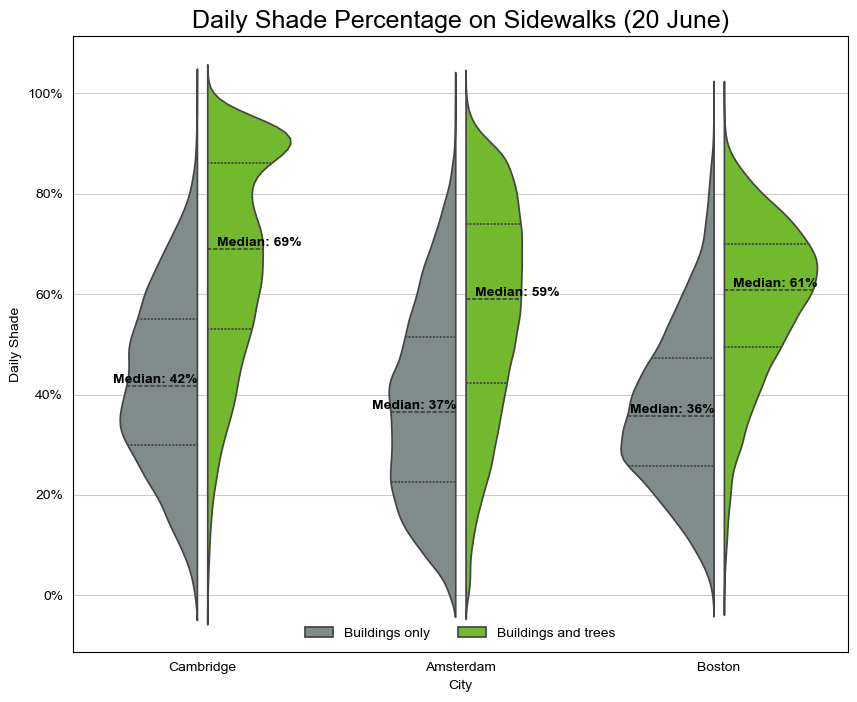

In [27]:
dfs = [melt_sidewalks_cam,melt_sidewalks_ams,melt_boston]
cities = ['Cambridge','Amsterdam','Boston']
vis.plot_shade_metrics_for_cities(dfs, cities, background='light', title='Daily Shade Percentage on Sidewalks (20 June)', save_path='../results/figures/', file_name=f'241001_daily_multiple_cities_light')

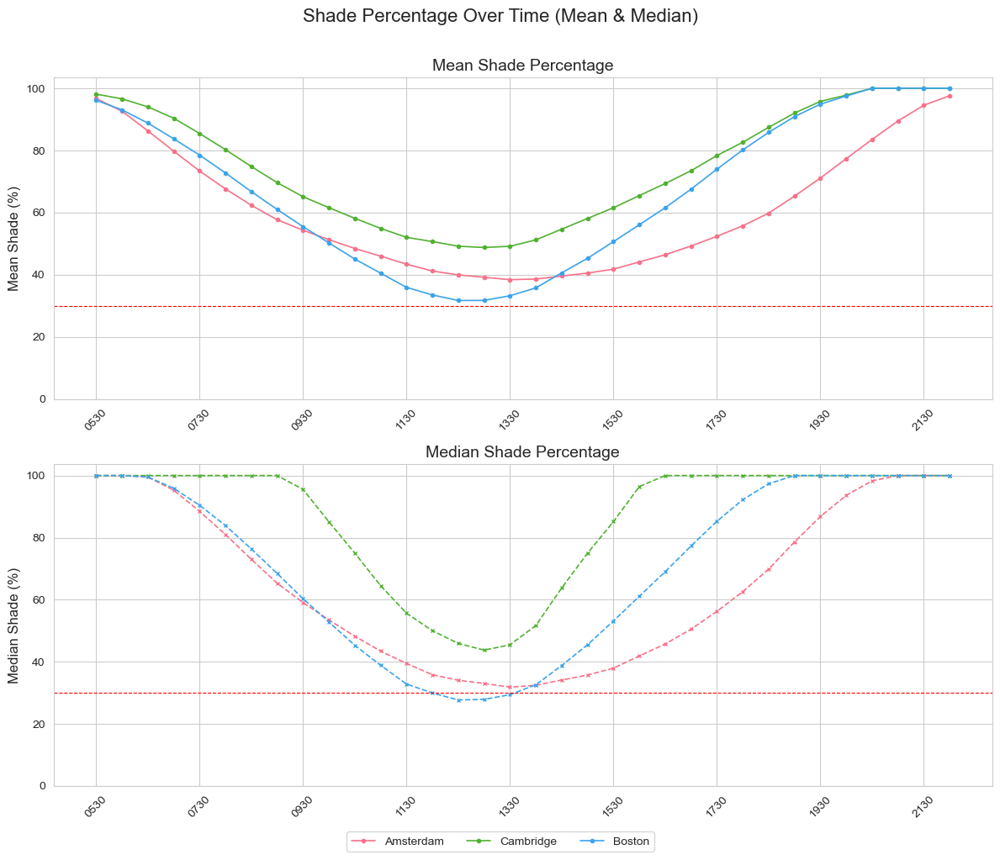

In [28]:
# Create a dictionary of DataFrames
df_dict = {
    'Amsterdam': sidewalks_ams,
    'Cambridge': sidewalks_cam,
    'Boston': clean_boston
}
cities = list(df_dict.keys()) 
dates = ['20240620']
# Example usage with a DataFrame
time_increments = ['0530', '0600', '0630', '0700', '0730', '0800', '0830', '0900', '0930', '1000', '1030', '1100', '1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700', '1730', '1800', '1830', '1900', '1930', '2000', '2030', '2100', '2130', '2200']
# time_increments = ['09:00', '09:30', '10:00', '10:30', '11:00', '11:30', '12:00', '12:30', '13:00', '13:30', '14:00', '14:30', '15:00', '15:30', '16:00', '16:30', '17:00', '17:30', '18:00', '18:30', '19:00']

vis.plot_shade_statistics_per_city(df_dict, cities, time_increments, column_prefix='20240620_tree_shade_percent_at_', title='Shade Percentage Over Time (Mean & Median)')

In [ ]:
vis.plot_shade_statistics_per_city(df_dict, cities, time_increments, column_prefix_1='20240620_building_shade_percent_at_', column_prefix_2='20240620_tree_shade_percent_at_', title='Shade Percentage Over Time (Mean & Median)')

In [6]:
### Isolate Boston Downtown
downtown = clean_boston.loc[clean_boston.DISTRICT =='DOWNTOWN']

# # Example usage:
# datasets = [clean_boston, downtown]  # Add your datasets here
# dataset_names = ['All Boston', 'Downtown']  # Names corresponding to the datasets

# dates = ['20240620']
# times = [
#     '0600', '0630', '0700', '0730', '0800', '0830',
#     '0900', '0930', '1000', '1030', '1100', '1130',
#     '1200', '1230', '1300', '1330', '1400', '1430',
#     '1500', '1530', '1600', '1630', '1700', '1730',
#     '1800', '1830', '1900'
# ]

# vis.plot_shade_comparison(datasets, dataset_names, dates, times, '2315704', 'Shade percentage over time', save_path='../results/figures/', meanline_color='orange')

In [11]:
cycling_ams = clean_amsterdam.loc[clean_amsterdam['Gebruiksfunctie']=='Cycle lane']
sidewalks_ams = clean_amsterdam.loc[clean_amsterdam['Gebruiksfunctie']=='Sidewalk']
driving_ams = clean_amsterdam.loc[clean_amsterdam['Gebruiksfunctie']=='Road']

In [14]:
clean_cambridge.surface_type.unique()

array(['Sidewalks', 'Public Footpaths', 'Private Walkways', 'Plazas',
       'Roads'], dtype=object)

In [19]:
sidewalks_cam = clean_cambridge.loc[clean_cambridge['surface_type']=='Sidewalks']
driving_cam = clean_cambridge.loc[clean_cambridge['surface_type']=='Roads']

Plot saved to ../results/figures/20241001_2315704_2315704_comparison_plot_rows.png


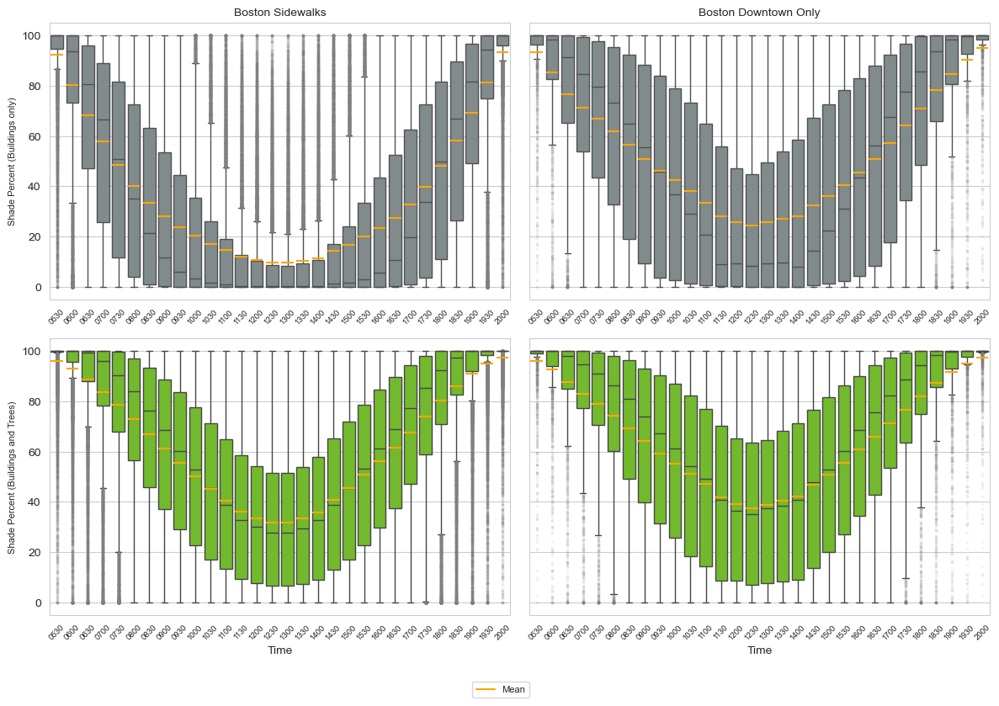

In [24]:
# Example usage:
datasets = [clean_boston, downtown]  # Add your datasets here
dataset_names = ['Boston Sidewalks', 'Boston Downtown Only']  # Names corresponding to the datasets

dates = ['20240620']
times = [
    '0500','0530',
    '0600', '0630', '0700', '0730', '0800', '0830',
    '0900', '0930', '1000', '1030', '1100', '1130',
    '1200', '1230', '1300', '1330', '1400', '1430',
    '1500', '1530', '1600', '1630', '1700', '1730',
    '1800', '1830', '1900', '1930', '2000', '2030',
    '2100', '2130',
]

vis.plot_shade_comparison_rows(datasets, dataset_names, dates, times, '2315704_2315704', 'Shade percentage over time', save_path='../results/figures/', meanline_color='orange')

Plot saved to ../results/figures/20240930_2315704_271110_comparison_plot_rows.png


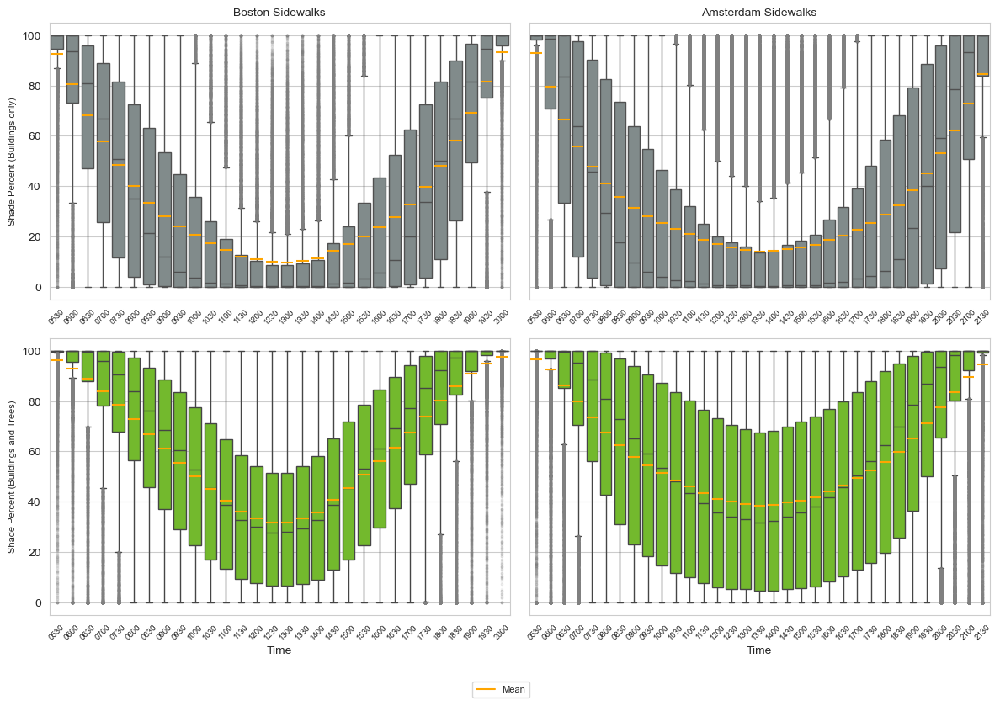

In [12]:
# Example usage:
datasets = [clean_boston, sidewalks_ams]  # Add your datasets here
dataset_names = ['Boston Sidewalks', 'Amsterdam Sidewalks']  # Names corresponding to the datasets

dates = ['20240620']
times = [
    '0500','0530',
    '0600', '0630', '0700', '0730', '0800', '0830',
    '0900', '0930', '1000', '1030', '1100', '1130',
    '1200', '1230', '1300', '1330', '1400', '1430',
    '1500', '1530', '1600', '1630', '1700', '1730',
    '1800', '1830', '1900', '1930', '2000', '2030',
    '2100', '2130',
]

vis.plot_shade_comparison_rows(datasets, dataset_names, dates, times, '2315704_271110', 'Shade percentage over time', save_path='../results/figures/', meanline_color='orange')

/Users/lbeuster/Documents/SAL/Projects/throwing_shade/code/analysis_plotting.py:308: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  #             ax.set_xlabel('')
/Users/lbeuster/Documents/SAL/Projects/throwing_shade/code/analysis_plotting.py:313: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  #                 ax.set_ylabel('')  # No y-label for other subplots


/Users/lbeuster/Documents/SAL/Projects/throwing_shade/code/analysis_plotting.py:313: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  #                 ax.set_ylabel('')  # No y-label for other subplots


Plot saved to ../results/figures/20240930_2315704_271110_comparison_plot.png


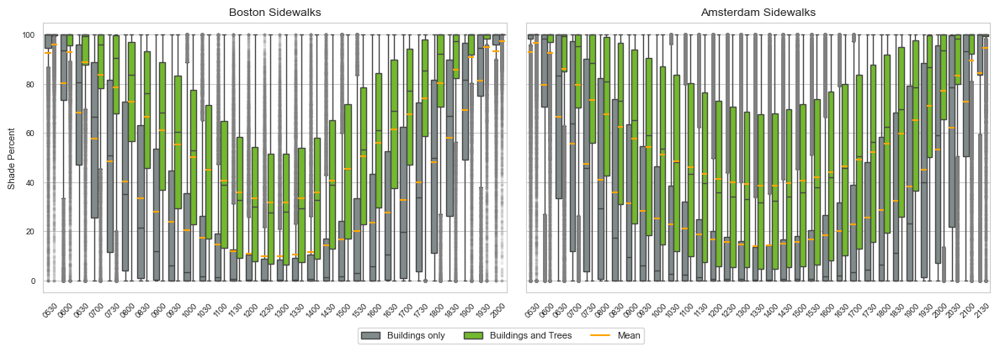

In [39]:
vis.plot_shade_comparison(datasets, dataset_names, dates, times, '2315704_271110', 'Shade percentage over time', save_path='../results/figures/', meanline_color='orange')

In [ ]:
# Example usage:
datasets = [sidewalks_cam, sidewalks_ams]  # Add your datasets here
dataset_names = ['Cambridge Sidewalks', 'Amsterdam Sidewalks']  # Names corresponding to the datasets

dates = ['20240620']
times = [
    '0500','0530',
    '0600', '0630', '0700', '0730', '0800', '0830',
    '0900', '0930', '1000', '1030', '1100', '1130',
    '1200', '1230', '1300', '1330', '1400', '1430',
    '1500', '1530', '1600', '1630', '1700', '1730',
    '1800', '1830', '1900', '1930', '2000', '2030',
    '2100', '2130',
]

vis.plot_shade_comparison_rows(datasets, dataset_names, dates, times, '1933745_271110', 'Shade percentage over time', save_path='../results/figures/', meanline_color='orange')

Plot saved to ../results/figures/20240930_1933745_271110_comparison_plot_rows.png


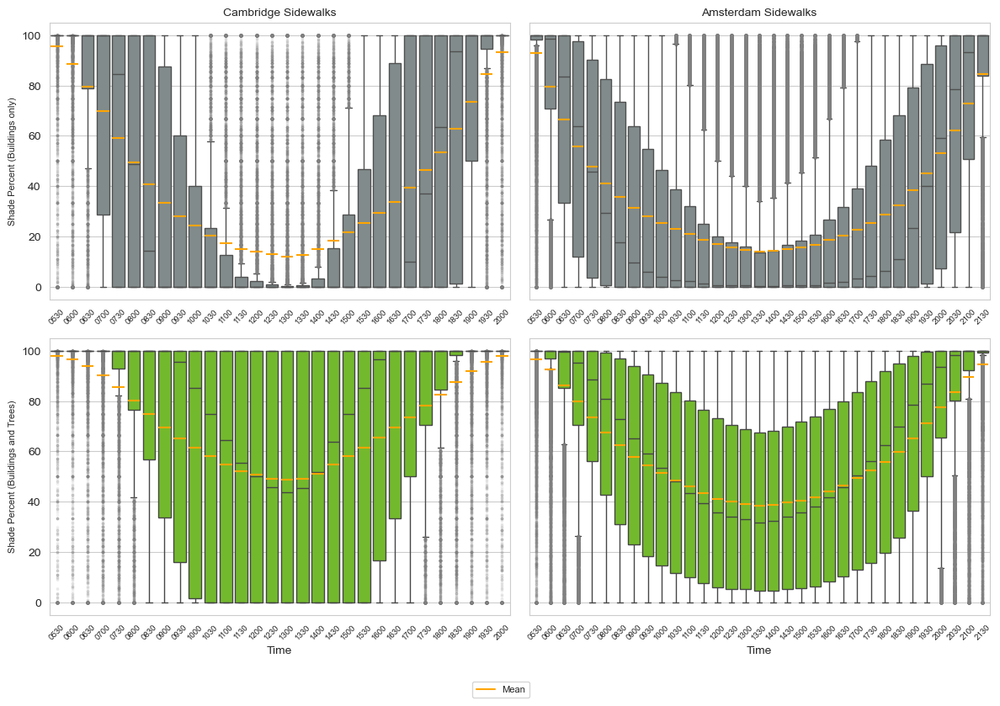

In [20]:
# Example usage:
datasets = [sidewalks_cam, sidewalks_ams]  # Add your datasets here
dataset_names = ['Cambridge Sidewalks', 'Amsterdam Sidewalks']  # Names corresponding to the datasets

dates = ['20240620']
times = [
    '0500','0530',
    '0600', '0630', '0700', '0730', '0800', '0830',
    '0900', '0930', '1000', '1030', '1100', '1130',
    '1200', '1230', '1300', '1330', '1400', '1430',
    '1500', '1530', '1600', '1630', '1700', '1730',
    '1800', '1830', '1900', '1930', '2000', '2030',
    '2100', '2130',
]

vis.plot_shade_comparison_rows(datasets, dataset_names, dates, times, '1933745_271110', 'Shade percentage over time', save_path='../results/figures/', meanline_color='orange')

Plot saved to ../results/figures/20240930_1933745_2315704_comparison_plot_rows.png


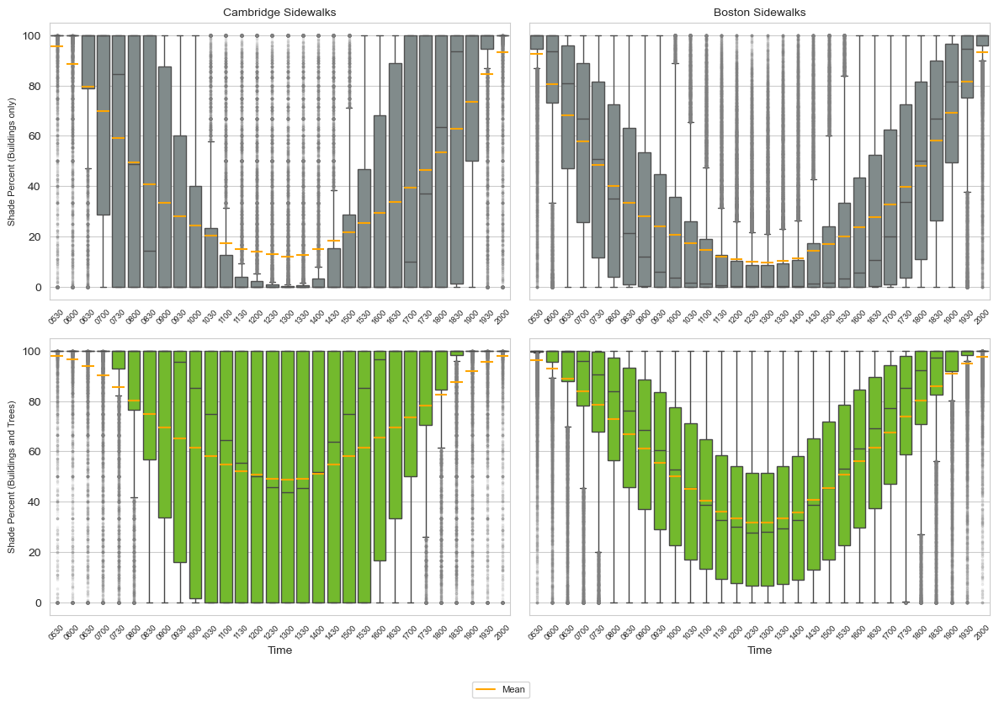

In [22]:
# Example usage:
datasets = [sidewalks_cam, clean_boston]  # Add your datasets here
dataset_names = ['Cambridge Sidewalks', 'Boston Sidewalks']  # Names corresponding to the datasets

dates = ['20240620']
times = [
    '0500','0530',
    '0600', '0630', '0700', '0730', '0800', '0830',
    '0900', '0930', '1000', '1030', '1100', '1130',
    '1200', '1230', '1300', '1330', '1400', '1430',
    '1500', '1530', '1600', '1630', '1700', '1730',
    '1800', '1830', '1900', '1930', '2000', '2030',
    '2100', '2130',
]

vis.plot_shade_comparison_rows(datasets, dataset_names, dates, times, '1933745_2315704', 'Shade percentage over time', save_path='../results/figures/', meanline_color='orange')

Plot saved to ../results/figures/20240930_1933745_1933745_comparison_plot_rows.png


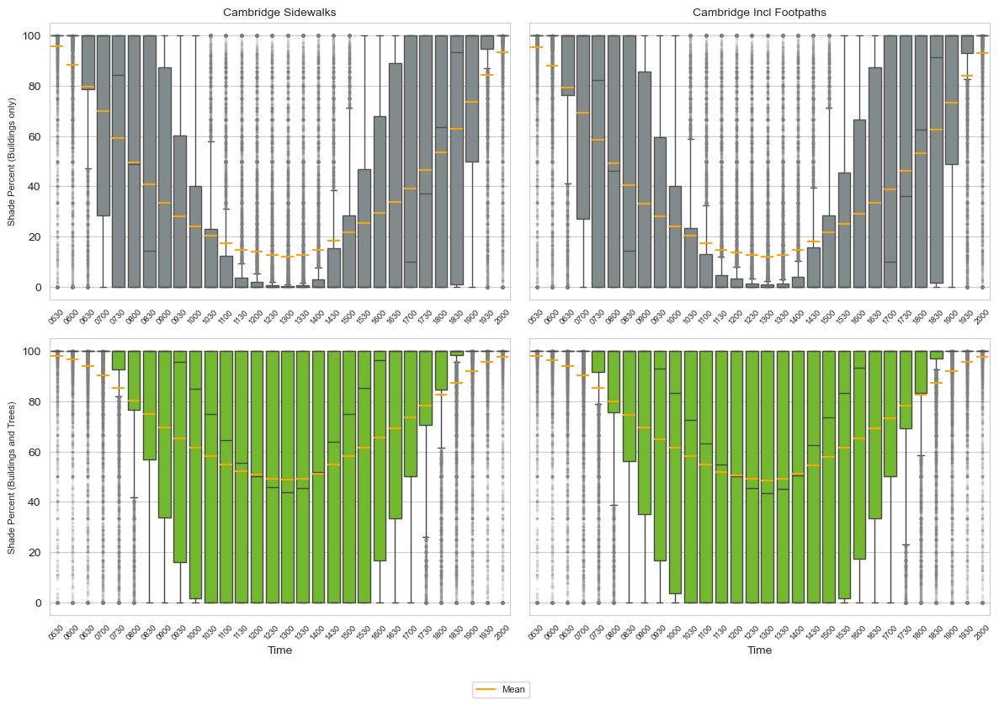

In [34]:
# Example usage:
datasets = [sidewalks_cam, footpaths_cam]  # Add your datasets here
dataset_names = ['Cambridge Sidewalks', 'Cambridge Incl Footpaths']  # Names corresponding to the datasets

dates = ['20240620']
times = [
    '0500','0530',
    '0600', '0630', '0700', '0730', '0800', '0830',
    '0900', '0930', '1000', '1030', '1100', '1130',
    '1200', '1230', '1300', '1330', '1400', '1430',
    '1500', '1530', '1600', '1630', '1700', '1730',
    '1800', '1830', '1900', '1930', '2000', '2030',
    '2100', '2130',
]

vis.plot_shade_comparison_rows(datasets, dataset_names, dates, times, '1933745_1933745', 'Shade percentage over time', save_path='../results/figures/', meanline_color='orange')

In [33]:
footpaths_cam = clean_cambridge.loc[(clean_cambridge['surface_type']=='Sidewalks') | (clean_cambridge['surface_type']=='Public Footpaths')]
print(len(sidewalks_cam))
print(len(footpaths_cam))

17025
17482


In [29]:
sidewalks_cam[0:2000].explore(column='20240620_tree_shade_percent_at_0830', cmap='viridis')

Plot saved to ../results/figures/20240930_1933745_271110_roads_comparison_plot_rows.png


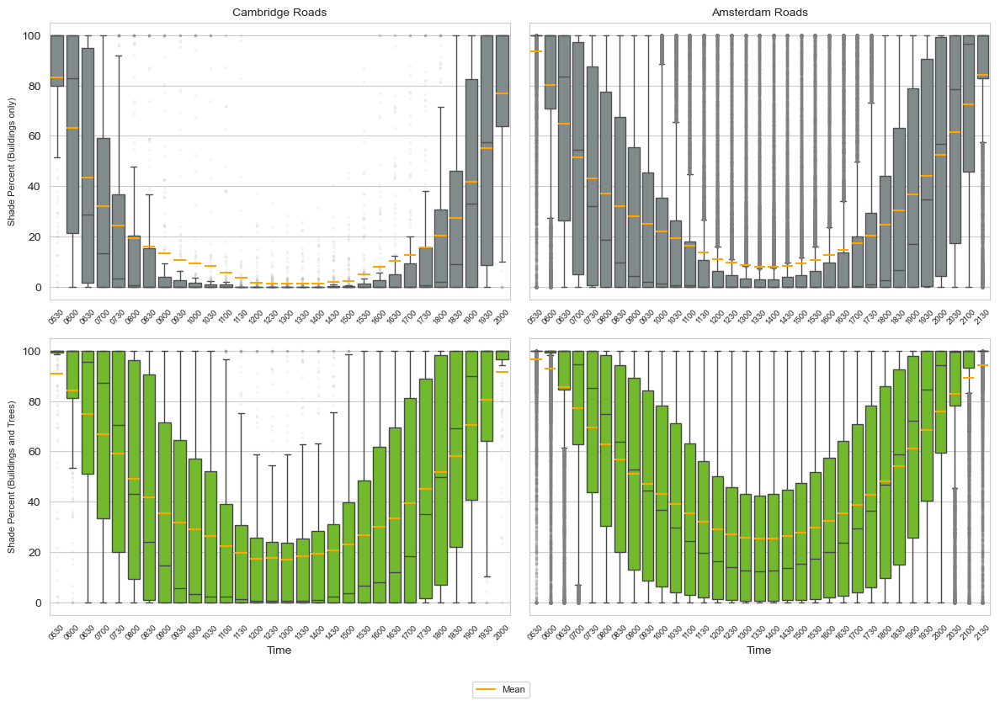

In [23]:
# Example usage:
datasets = [driving_cam, driving_ams]  # Add your datasets here
dataset_names = ['Cambridge Roads', 'Amsterdam Roads']  # Names corresponding to the datasets

dates = ['20240620']
times = [
    '0500','0530',
    '0600', '0630', '0700', '0730', '0800', '0830',
    '0900', '0930', '1000', '1030', '1100', '1130',
    '1200', '1230', '1300', '1330', '1400', '1430',
    '1500', '1530', '1600', '1630', '1700', '1730',
    '1800', '1830', '1900', '1930', '2000', '2030',
    '2100', '2130',
]

vis.plot_shade_comparison_rows(datasets, dataset_names, dates, times, '1933745_271110_roads', 'Shade percentage over time', save_path='../results/figures/', meanline_color='orange')